# Using SpatialTis with Jupyter notebook

This is a tutorial of SpatialTis, I will walk you through the essential part of the pacakge.

If you have a dataset can be processed on your own computer, using Jupyter environment for data analysis and visuzlization is pretty convenient.

## Data description

In this example I use MIBI dataset from this article:

[A Structured Tumor-Immune Microenvironment in Triple Negative Breast Cancer Revealed by Multiplexed Ion Beam Imaging](https://www.cell.com/fulltext/S0092-8674(18)31100-0)

For origin data, follow their instruction in the article to request it.

The processed data is placed at their [lab's page](https://www.angelolab.com/mibi-data)

The data has been processed into anndata object. It contains 41 patients, one ROI per patient.


In [1]:
import numpy as np
import pandas as pd
import anndata as ad

In [2]:
import spatialtis as st
import spatialtis.plotting as sp
from spatialtis import CONFIG

First let's read the data, I have already processed their processed data into anndata object.

Because some of the background region are also marked as a cell in their mask images, we can filter out most of it based on area size.

In [3]:
data = ad.read_h5ad("data/mibi_data.h5ad")
data = data[data.obs['area'] < 1000].copy()
data

AnnData object with n_obs × n_vars = 181376 × 39
    obs: 'Patient', 'area', 'cell_shape', 'centroid', 'eccentricity', 'cell_type'
    var: 'markers'

Before going into analysis, it would be convenient if we set some global config first, so no need to specific them every time afterwards. But you can always change some setting by passing parameters into the function.

In [4]:
CONFIG.EXP_OBS = ['Patient'] # how the experiment design
CONFIG.CELL_TYPE_KEY = "cell_type" # The key that store cell type info in anndata.obs
CONFIG.MARKER_KEY = "markers" # The key that store marker info in anndata.var
CONFIG.MULTI_PROCESSING = True # turn on multiprocessing

You can list the current configuration of SpatialTis, but this is not everything, refer to the documentation for more configuration

In [5]:
CONFIG

Current configurations of SpatialTis:

======CONFIGURATIONS======
EXP_OBS: ['Patient']
OS: Darwin
MULTI_PROCESSING: True
CPU_ALLOC: None
WORKING_ENV: jupyter
VERBOSE.PBAR: True
VERBOSE.ANNDATA: True
VERBOSE.INFO: True

======KEYS======
CELL_TYPE_KEY: cell_type
CENTROID_KEY: centroid
AREA_KEY: area
SHAPE_KEY: cell_shape
ECCENTRICITY_KEY: eccentricity
MARKER_KEY: markers

## Visualization of ROI

If you have cell shape data, you can visualiza certain ROI, select the cells to highlight

Click the legend to mute certain cell type

In [6]:
sp.cell_map(data, {'Patient':'Patient 1'}, size=(500, 800))

In [7]:
sp.cell_map(data, {'Patient':'Patient 1'}, geom="point", size=(500, 800))

Visualization of marker expression in an ROI is also avaialble.

In [8]:
sp.expression_map(data, {'Patient':'Patient 1'}, order=['CD4', 'CD8', 'CD20'], size=(650, 600))

In [9]:
sp.expression_map(data, {'Patient':'Patient 1'}, use="scatter", order=['CD4', 'CD8', 'CD20'], size=(650, 650))

## Basic Statistic of spatial single cell data

- Cell components
- Cell density
- Cell morphology (eg. area, eccentricity...)
- Cell co-occurrence

### Cell components

This is to count the fraction of each cell type in different group

In [10]:
st.cell_components(data)

Running cell components
Added to AnnData, uns: 'cell_components'
Finished! Used 41ms


To visualize the every analysis results, there is always a plotting function with same name as the analysis function.

For example: the plotting function for `st.cell_components` is `sp.cell_components`

In [11]:
immune_cells = ['Macrophages', 'Tregs', 'CD4 T', 'CD3 T', 'CD8 T', 'NK', 'B', 'Neutrophils', 'DC', 'DC/Mono']
sp.cell_components(data, ['Patient'], 
                   size=(400, 1000), 
                   selected_types=immune_cells, 
                   sort_type='Macrophages',
                   title="Immune Cells' Components",
                   xaxis_title="Patients", 
                   yaxis_title="Percentage of cells(%)",
                  )

### Cell density

This is to measure the density of cell in each ROI

Depends on the unit you want to use, the ROI in this dataset is 2mm * 2mm, therefore the size is (2,2), the unit of cell density is $n$ cells/$mm^2$

In [12]:
st.cell_density(data, (2,2))

Running cell density
Added to AnnData, uns: 'cell_density'
Finished! Used 51ms


The Keratin-positive tumor is obviously much densed than other cell

In [13]:
selected_cells = ['Macrophages', 'Tregs', 'CD4 T', 'CD3 T', 'CD8 T', 'NK', 'B', 'Neutrophils', 'DC', 'DC/Mono', 
               'Keratin-positive tumor', 'Tumor','Endothelial', 'Mesenchymal-like']
sp.cell_density(data,
                selected_types=selected_cells,
                title="Cell density in 41 TNBC patinets", 
                yaxis_title="Number of cells/mm^2",
               )

### Cell morphology

This is to measure the area or the eccentricity of cells, the default is to use eccentricity. The value of eccentricity get more close to 1 means the shape of the cell is more close to a circle.

In [14]:
st.cell_morphology(data)

Running cell morphology
Added to AnnData, uns: 'cell_morphology'
Finished! Used 2s175ms


In [15]:
immune_cells = ['Macrophages', 'Tregs', 'CD4 T', 'CD3 T', 'CD8 T', 'NK', 'B', 'Neutrophils', 'DC', 'DC/Mono']
sp.cell_morphology(data, 
                   selected_types=immune_cells, 
                   size=(400, 600), 
                   title="Eccentricity of immune cells", 
                   yaxis_title="eccentricity",
                   palette=["#77b93d"],
                  )

### Cell co-occurrence

This is to measure the likelihood of two type of cells occur in the same ROI

In [16]:
st.cell_co_occurrence(data)

Running cell co-occurrence
Added to AnnData, uns: 'cell_co_occurrence'
Finished! Used 320ms


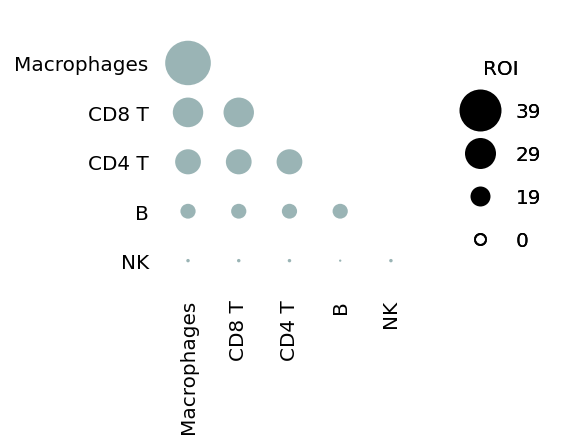

In [17]:
immune_cells = ['Macrophages', 'CD8 T', 'CD4 T', 'B', 'NK']
sp.cell_co_occurrence(data, ['Patient'], selected_types=immune_cells)

## Get SpatialTis's analysis result

Before we going further, you might wander how to access the results of SpatialTis's analysis in case you want to have further analysis or have your own visualization.

**Method 1**: use argument `return_df=True`

In [18]:
result = st.cell_components(data, return_df=True)

Running cell components
Added to AnnData, uns: 'cell_components'
Finished! Used 48ms


**Method 2**: read from the anndata.uns, if you know the key that store the SpatialTis's results

In [19]:
result = st.adata_uns2df(data, "cell_components")

In [20]:
result

,type,Keratin-positive tumor,CD3 T,B,CD4 T,DC/Mono,Unidentified,Macrophages,CD8 T,Other immune,Endothelial,Mono/Neu,Mesenchymal-like,Neutrophils,NK,Tumor,DC,Tregs
Patient,id,,,,,,,,,,,,,,,,,
Patient 1,0,2356,286,1078,231,163,40,265,161,201,34,3,40,10,5,1,2,0
Patient 2,1,1463,9,2,18,5,5,405,193,35,81,43,106,8,11,1,29,0
Patient 3,2,2091,199,397,454,408,16,661,467,259,105,21,692,18,12,23,35,20
Patient 4,3,1552,346,303,674,421,26,828,287,665,125,47,197,120,6,393,2,169
Patient 5,4,1876,106,2,226,307,34,940,479,159,176,166,218,63,1,15,2,42
Patient 6,5,3049,119,30,116,177,75,625,192,397,102,433,117,12,0,14,0,3
Patient 7,6,2275,1,0,1,2,92,224,3,9,4,7,104,268,0,75,0,0
Patient 8,7,1243,28,5,2,17,123,231,41,93,1,46,307,7,0,480,0,0
Patient 9,8,2445,211,60,310,196,45,1116,357,355,65,145,48,107,5,45,66,53


## Spatial analysis

- Spatial distribution
- Spatial heterogeneity
- Neighborhood analysis
- Hotspot detection
- Spatial community detection
- Marker influenced by neighbor cells/markers

### Spatial distribution

The pattern of spatial distribution is `Random`, `Cluster`, `Regular`.

In [21]:
st.spatial_distribution(data)

Running plotting distribution
Method: Nearest neighbors search
find distribution pattern: 100%|██████████| 40/40 [00:12<00:00,  3.30ROI/s]
Added to AnnData, uns: 'spatial_distribution'
Finished! Used 12s192ms


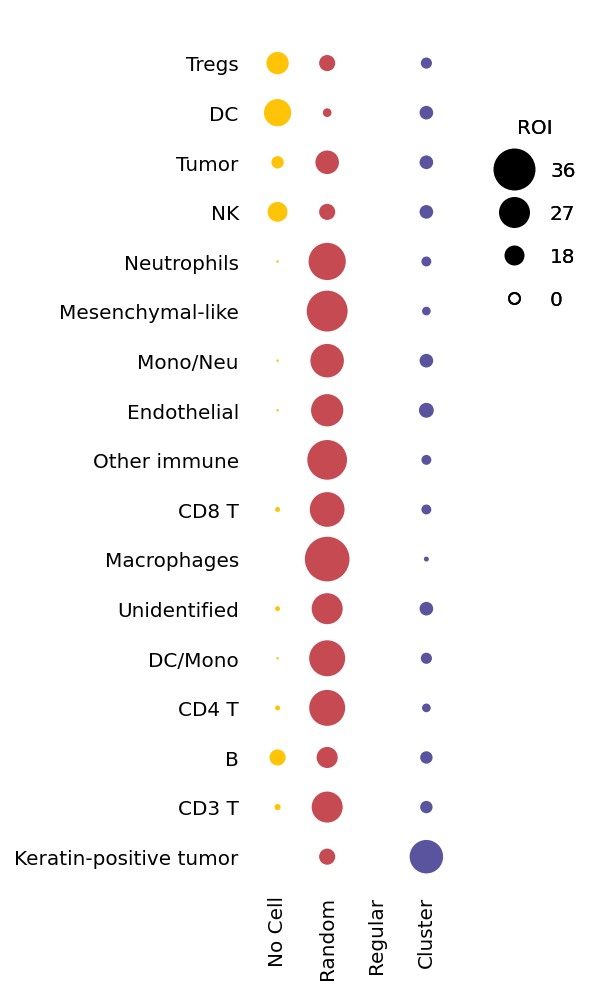

In [22]:
sp.spatial_distribution(data, use="dot")

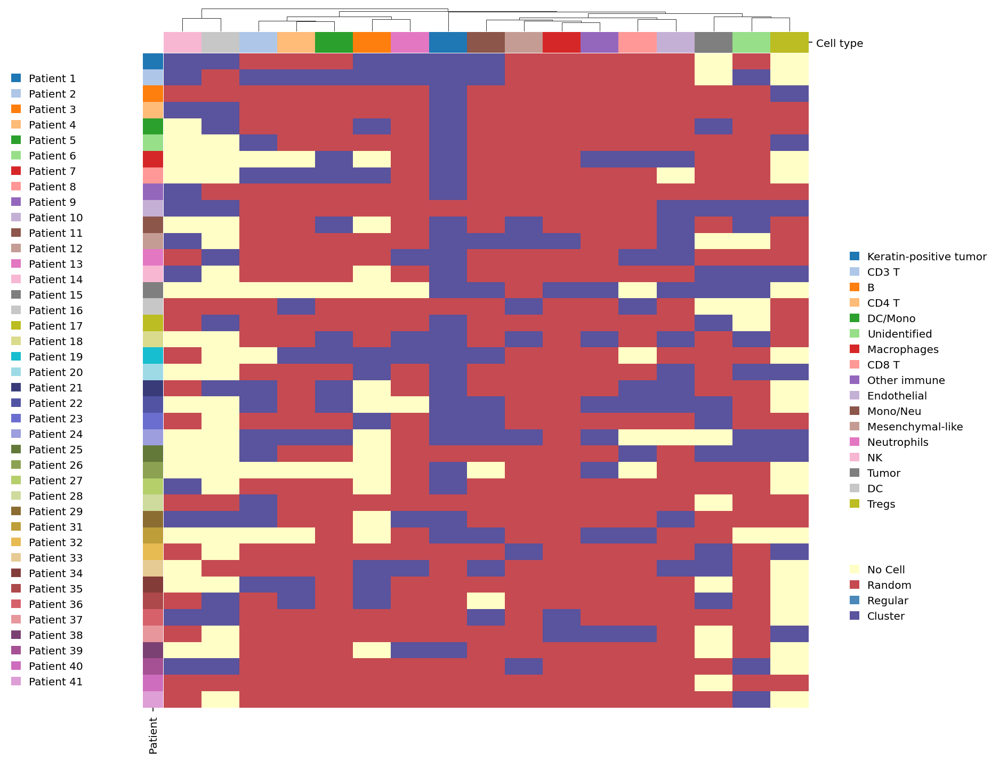

In [23]:
sns_heatmap_args = dict(method="ward")
sp.spatial_distribution(data, ['Patient'], use="heatmap", colorbar_bbox=(1.05, 0.1, 0.03, 0.15), **sns_heatmap_args)

### Spatial Heterogeneity

SpatialTis implemented 3 entropy based methods to quantify the spatial heterogeneity

- Shannon entropy
- Altieri entropy
- Leibovici entropy

In [24]:
st.spatial_heterogeneity(data, method="altieri", cut=10)

Running plotting heterogeneity
Method: Altieri entropy
heterogeneity: 100%|██████████| 40/40 [01:19<00:00,  1.98s/ROI]
Added to AnnData, uns: 'spatial_heterogeneity'
Finished! Used 1m25s


In [25]:
sp.spatial_heterogeneity(data, size=(500, 1000))

### Finding cell neighbors

Intiate a `Neighbors` instance to find neighbors for each cells.

This MIBI dataset has cell shape data, we can search using default setting. For data resolved cell as point, pass `geom="point"`

In [26]:
n = st.Neighbors(data)

SpatialTis search the neighbors of a cell by enlarge the cell

`scale=1.5` will scale the cell at 1.5 fold (shape data)

`expand=5` will expand the cell by 5 unit (shape data, point data)

In [27]:
n.find_neighbors(expand=5)
n.export_neighbors()

Cell resolved as shape data, searching neighbors using R-tree
find neighbors: 100%|██████████| 40/40 [00:18<00:00,  2.20ROI/s]
Added to AnnData, obs: 'cell_neighbors'


You can also visualize the cell neighbors in any ROI

In [28]:
sp.cell_neighbors(data, {'Patient': 'Patient 1'})

### Neighborhood analysis

The default is the same as the histocat's neighborhood analysis, heatmap using the same visulization

<div class="alert alert-block alert-info">
Notice something is different in the parameter of the following analysis function, we pass in (n) a spatialtis.Neighbor instance instead of (data) a anndata object.
</div>

You should set higher resample time (500~1000 times or more) when doing real analysis

In [29]:
st.neighborhood_analysis(n, resample=50)

Running neighborhood analysis
neighborhood analysis: 100%|██████████| 40/40 [01:45<00:00,  2.64s/ROI]
Added to AnnData, uns: 'neighborhood_analysis'
Finished! Used 1m45s


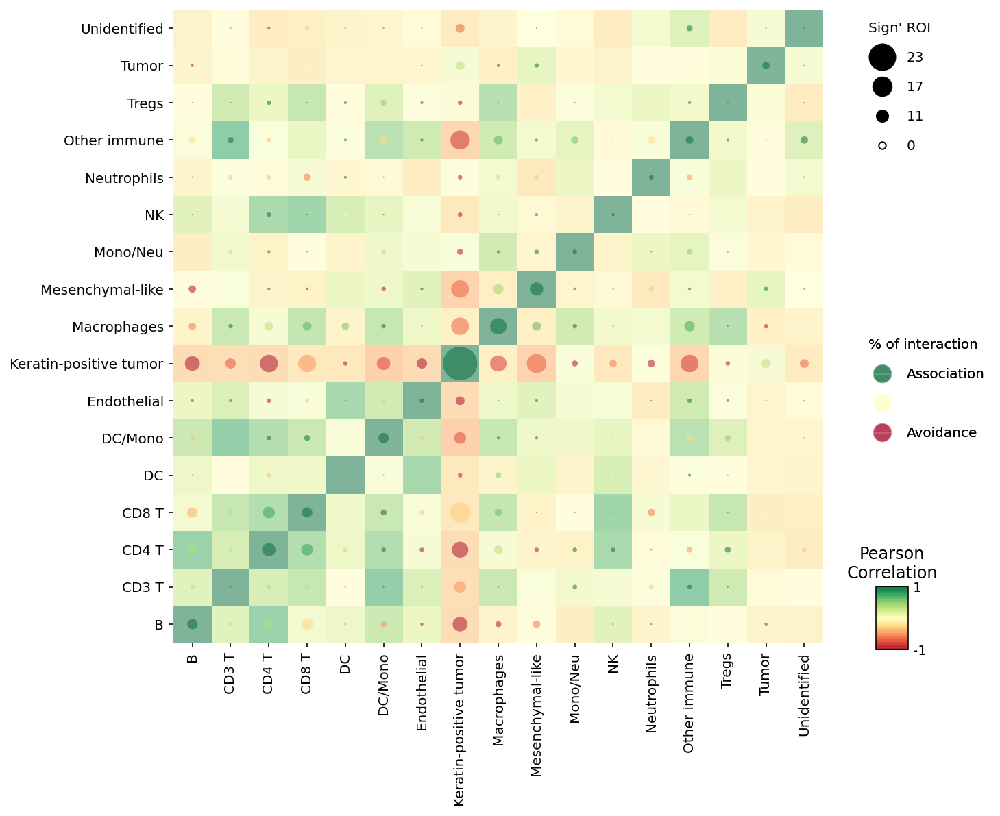

In [30]:
sp.neighborhood_analysis(data)

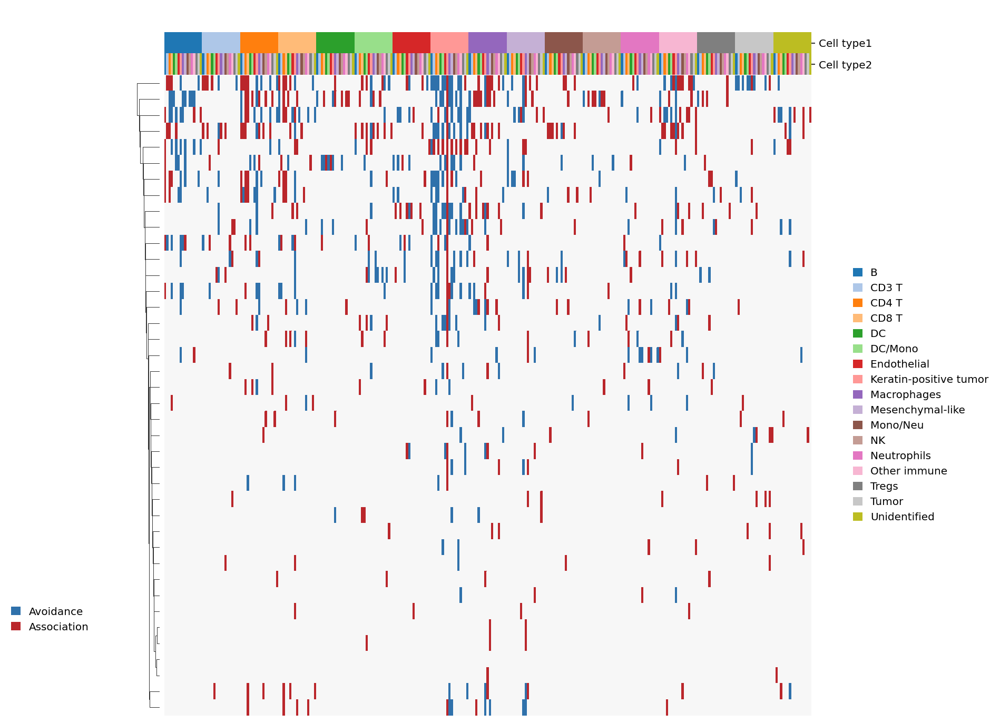

In [31]:
sp.neighborhood_analysis(data, use="heatmap")

### Cell communities detection

Leiden algorithm for communities detection

In [32]:
n.export_neighbors()
n.read_neighbors()

Added to AnnData, obs: 'cell_neighbors'


In [33]:
st.communities(n)

find communities: 100%|██████████| 40/40 [00:02<00:00, 13.91ROI/s]


In [34]:
sp.cell_communities(data, {'Patient': 'Patient 1'})

### Marker influence by neighbor cells

<div class="alert alert-block alert-danger">
    
When processing your own data, you should use higher std and importance value as threshold, i set a low value here only for illustration
     
</div>

In [35]:
st.exp_neighcells(n)

Finding marker expression influenced by neighbor cells
fit model: 100%|██████████| 663/663 [00:15<00:00, 42.89regressor/s]
Added to AnnData, uns: 'exp_neighcell'
Finished! Used 22s70ms


Take the first line as example, it's interpretated as: 

The **Tregs**'s **FoxP3** is affected by the occurrence of **Keratin-positive tumor** at it's neighbors

In [36]:
sp.exp_neighcells(data, score=0)

Always remember to save your results by writing to the anndata file, otherwise it only store in the RAM

In [37]:
#data.write(data)